## Setup

In [3]:
import numpy as np
from pathlib import Path
import os
import matplotlib.pyplot as plt
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import gc

from matplotlib.lines import Line2D
from matplotlib.colors import LogNorm
from fastkde.fastKDE import fastKDE
from scipy.stats import linregress

from harp_resources import process, utils
from sleap import load_and_process as lp

# symbols to use ✅ ℹ️ ⚠️ ❗

In [4]:
############################################################################################################
# set up variables and load data 
############################################################################################################

plot_timeseries = False
score_cutoff = 0.2 # for checking prediction accuracy
outlier_sd_threshold = 10 # for removing outliers from the data

# for saccades
framerate = 59.77  # Hz (in the future, should come from saved data)
threshold = 65  # px/s FIXME make this adaptive
refractory_period = pd.Timedelta(milliseconds=100)  # msec, using pd.Timedelta for datetime index
plot_saccade_detection_QC = True

data_path = Path('/Users/rancze/Documents/Data/vestVR/Cohort1/Visual_mismatch_day3/B6J2717-2024-12-10T12-17-03')
save_path = data_path.parent / f"{data_path.name}_processedData"


print ("\n❗ if SleapData.csv was already saved in the VideoData folder, this may break. Delete the file if you want to rerun processing\n")
VideoData1, VideoData2, VideoData1_Has_Sleap, VideoData2_Has_Sleap = lp.load_videography_data(data_path)
VideoData1 = VideoData1.drop(columns=['track']) # drop the track column as it is empty

columns_of_interest = ['left.x','left.y','center.x','center.y','right.x','right.y','p1.x','p1.y','p2.x','p2.y','p3.x','p3.y','p4.x','p4.y','p5.x','p5.y','p6.x','p6.y','p7.x','p7.y','p8.x','p8.y']
coordinates_dict=lp.get_coordinates_dict(VideoData1, columns_of_interest)


❗ if SleapData.csv was already saved in the VideoData folder, this may break. Delete the file if you want to rerun processing

ℹ️ Make sure the SLEAP files follow this convention: VideoData1_1904-01-01T00-00-00.sleap.csv

Outputs of SLEAP found in VideoData1: True
Outputs of SLEAP found in VideoData2: False
Found .csv VideoData logs timestamped at:
- 1904-01-06T01:00:00.000000000
- 1904-01-06T02:00:00.000000000
ℹ️ VideoData1 has 238 dropped frames. Filling missing frames with empty rows.


In [5]:
1/VideoData1["Seconds"].diff().mean() # frame rate, add to df as inmutable variable before saving for later analysis

59.77165380437805

In [6]:
############################################################################################################
# plot timeseries of coordinates in borwser 
############################################################################################################
if plot_timeseries:
    print(f'⚠️ Check for long discontinouties and outsiders in the data, we will try to deal with them later')
    print(f'ℹ️ Figure opens in browser window, takes a bit of time.')
    fig = make_subplots(
        rows=4, cols=1,
        shared_xaxes=True,
        vertical_spacing=0.05,
        subplot_titles=(
            "X coordinates for pupil centre add left-right eye corner",
            "Y coordinates for pupil centre add left-right eye corner",
            "X coordinates for iris points",
            "Y coordinates for iris points"
        )
    )

    # Row 1: Plot left.x, center.x, right.x
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['left.x'], mode='lines', name='left.x'), row=1, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['center.x'], mode='lines', name='center.x'), row=1, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['right.x'], mode='lines', name='right.x'), row=1, col=1)

    # Row 2: Plot left.y, center.y, right.y
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['left.y'], mode='lines', name='left.y'), row=2, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['center.y'], mode='lines', name='center.y'), row=2, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['right.y'], mode='lines', name='right.y'), row=2, col=1)

    # Row 3: Plot p.x coordinates for p1 to p8
    for col in ['p1.x', 'p2.x', 'p3.x', 'p4.x', 'p5.x', 'p6.x', 'p7.x', 'p8.x']:
        fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1[col], mode='lines', name=col), row=3, col=1)

    # Row 4: Plot p.y coordinates for p1 to p8
    for col in ['p1.y', 'p2.y', 'p3.y', 'p4.y', 'p5.y', 'p6.y', 'p7.y', 'p8.y']:
        fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1[col], mode='lines', name=col), row=4, col=1)

    fig.update_layout(
        height=1200,
        title_text="Time series subplots for coordinates",
        showlegend=True
    )
    fig.update_xaxes(title_text="Seconds", row=4, col=1)
    fig.update_yaxes(title_text="X Position", row=1, col=1)
    fig.update_yaxes(title_text="Y Position", row=2, col=1)
    fig.update_yaxes(title_text="X Position", row=3, col=1)
    fig.update_yaxes(title_text="Y Position", row=4, col=1)

    fig.show(renderer='browser')

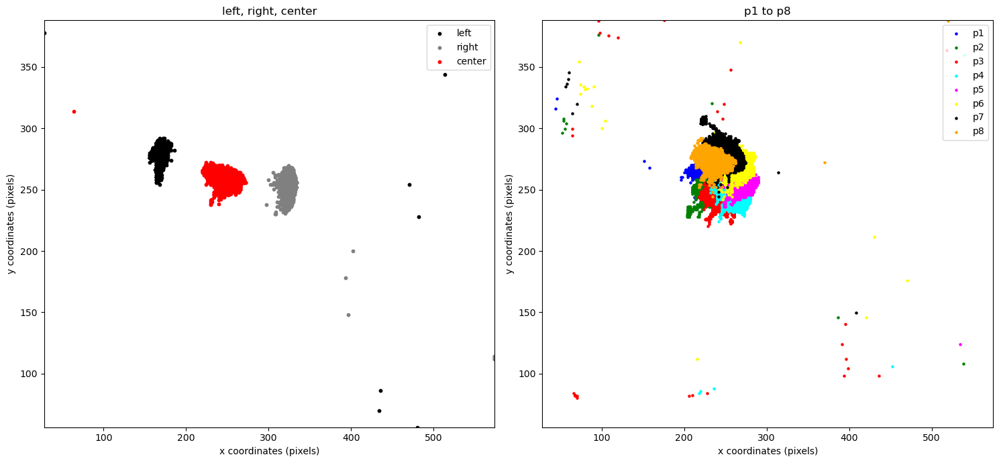

In [7]:
columns_of_interest = ['left', 'right', 'center', 'p1', 'p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8']

# Filter out NaN values and calculate the min and max values for X and Y coordinates
x_min = min([coordinates_dict[f'{col}.x'][~np.isnan(coordinates_dict[f'{col}.x'])].min() for col in columns_of_interest])
x_max = max([coordinates_dict[f'{col}.x'][~np.isnan(coordinates_dict[f'{col}.x'])].max() for col in columns_of_interest])
y_min = min([coordinates_dict[f'{col}.y'][~np.isnan(coordinates_dict[f'{col}.y'])].min() for col in columns_of_interest])
y_max = max([coordinates_dict[f'{col}.y'][~np.isnan(coordinates_dict[f'{col}.y'])].max() for col in columns_of_interest])

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 7))

# Plot left, right, and center in the first plot
ax[0].set_title('left, right, center')
ax[0].scatter(coordinates_dict['left.x'], coordinates_dict['left.y'], color='black', label='left', s=10)
ax[0].scatter(coordinates_dict['right.x'], coordinates_dict['right.y'], color='grey', label='right', s=10)
ax[0].scatter(coordinates_dict['center.x'], coordinates_dict['center.y'], color='red', label='center', s=10)
ax[0].set_xlim([x_min, x_max])
ax[0].set_ylim([y_min, y_max])
ax[0].set_xlabel('x coordinates (pixels)')
ax[0].set_ylabel('y coordinates (pixels)')
ax[0].legend(loc='upper right')

# Plot p1 to p8 in the second plot with different colors and smaller markers
colors = ['blue', 'green', 'red', 'cyan', 'magenta', 'yellow', 'black', 'orange']
for idx, col in enumerate(columns_of_interest[3:]):
    ax[1].scatter(coordinates_dict[f'{col}.x'], coordinates_dict[f'{col}.y'], color=colors[idx], label=col, s=5)

ax[1].set_xlim([x_min, x_max])
ax[1].set_ylim([y_min, y_max])
ax[1].set_title('p1 to p8')
ax[1].set_xlabel('x coordinates (pixels)')
ax[1].set_ylabel('y coordinates (pixels)')
ax[1].legend(loc='upper right')

plt.tight_layout()
plt.show()


In [8]:
############################################################################################################
# deal with frames where all points are NaN
############################################################################################################

columns_of_interest = ['left.x','left.y','center.x','center.y','right.x','right.y','p1.x','p1.y','p2.x','p2.y','p3.x','p3.y','p4.x','p4.y','p5.x','p5.y','p6.x','p6.y','p7.x','p7.y','p8.x','p8.y']

all_nan_df = VideoData1[VideoData1[columns_of_interest].isnull().all(1)]
all_nan_index_array = all_nan_df.index.values

# print the groups of sequential NaNs
group_counts = {'1-5': 0, '6-10': 0, '>10': 0}
i = 1
for group in lp.find_sequential_groups(all_nan_index_array):
    #print(f'NaN frame group {i} with {len(group)} elements')
    if 1 <= len(group) <= 5:
        group_counts['1-5'] += 1
    elif 6 <= len(group) <= 10:
        group_counts['6-10'] += 1
    else:
        group_counts['>10'] += 1
        print(f'⚠️ Framegroup {i} has {len(group)} consecutive all NaN frames  with indices {group}. If this is a long group, consider checking the data.')
    i += 1

print(f"Framegroups with 1-5 consecutive all NaN frames: {group_counts['1-5']}")
print(f"Framegroups with 6-10 consecutive all NaN frames: {group_counts['6-10']}")
print(f"Framegroups with >10 consecutive all NaN frames: {group_counts['>10']}")

############################################################################################################
# check if we can use some filtering on scores to remove bad frames
############################################################################################################

score_cutoff = 0.2
columns_of_interest = ['left.score','center.score','right.score','p1.score','p2.score','p3.score','p4.score','p5.score','p6.score','p7.score','p8.score']
total_points = len(VideoData1)
print(f'\nℹ️ Number of frames and consequitve sequences below {score_cutoff} confidence score.')

for col in columns_of_interest:
    count_below_threshold = (VideoData1[col] < score_cutoff).sum()
    percentage_below_threshold = (count_below_threshold / total_points) * 100
    
    # Find the longest consecutive series below threshold
    below_threshold = VideoData1[col] < score_cutoff
    longest_series = 0
    current_series = 0
    
    for value in below_threshold:
        if value:
            current_series += 1
            if current_series > longest_series:
                longest_series = current_series
        else:
            current_series = 0
    
    print(f"Column: {col} | Values below {score_cutoff}: {count_below_threshold} ({percentage_below_threshold:.2f}%) | Longest consecutive frame series: {longest_series}")



⚠️ Framegroup 52 has 15 consecutive all NaN frames  with indices [67494, 67495, 67496, 67497, 67498, 67499, 67500, 67501, 67502, 67503, 67504, 67505, 67506, 67507, 67508]. If this is a long group, consider checking the data.
⚠️ Framegroup 53 has 15 consecutive all NaN frames  with indices [67517, 67518, 67519, 67520, 67521, 67522, 67523, 67524, 67525, 67526, 67527, 67528, 67529, 67530, 67531]. If this is a long group, consider checking the data.
Framegroups with 1-5 consecutive all NaN frames: 51
Framegroups with 6-10 consecutive all NaN frames: 8
Framegroups with >10 consecutive all NaN frames: 2

ℹ️ Number of frames and consequitve sequences below 0.2 confidence score.
Column: left.score | Values below 0.2: 2422 (2.17%) | Longest consecutive frame series: 360
Column: center.score | Values below 0.2: 436 (0.39%) | Longest consecutive frame series: 294
Column: right.score | Values below 0.2: 4258 (3.81%) | Longest consecutive frame series: 101
Column: p1.score | Values below 0.2: 385 (

### SLEAP processing

In [9]:
############################################################################################################
# center coordinates on median pupil centre 
############################################################################################################

columns_of_interest = ['left.x','left.y','center.x','center.y','right.x','right.y','p1.x','p1.y','p2.x','p2.y','p3.x','p3.y','p4.x','p4.y','p5.x','p5.y','p6.x','p6.y','p7.x','p7.y','p8.x','p8.y']

# Calculate the mean of the center x and y points
mean_center_x = VideoData1['center.x'].median()
mean_center_y = VideoData1['center.y'].median()

print(f"Mean center.x: {mean_center_x}, Mean center.y: {mean_center_y}")

# Translate the coordinates
for col in columns_of_interest:
    if '.x' in col:
        VideoData1[col] = VideoData1[col] - mean_center_x
    elif '.y' in col:
        VideoData1[col] = VideoData1[col] - mean_center_y

############################################################################################################
# remove outliers (x times SD) and interpolate between the previous and subsequent non-NaN value
############################################################################################################

# Calculate the standard deviation for each column of interest
std_devs = {col: VideoData1[col].std() for col in columns_of_interest}

# Calculate the number of outliers for each column
outliers = {col: ((VideoData1[col] - VideoData1[col].mean()).abs() > 10 * std_devs[col]).sum() for col in columns_of_interest}

# Find the channel with the maximum number of outliers
max_outliers_channel = max(outliers, key=outliers.get)
max_outliers_count = outliers[max_outliers_channel]

# Print the channel with the maximum number of outliers and the number
print(f"Channel with the maximum number of outliers: {max_outliers_channel}, Number of outliers: {max_outliers_count}")

# Print the total number of outliers
total_outliers = sum(outliers.values())
print(f"A total number of {total_outliers} outliers will be replaced by interpolation")

# Replace outliers by interpolating between the previous and subsequent non-NaN value
for col in columns_of_interest:
    outlier_indices = VideoData1[((VideoData1[col] - VideoData1[col].mean()).abs() > outlier_sd_threshold * std_devs[col])].index
    VideoData1.loc[outlier_indices, col] = np.nan

#VideoData1.interpolate(inplace=True)
VideoData1 = VideoData1.interpolate(method='linear', limit_direction='both')

Mean center.x: 247.86394500732422, Mean center.y: 259.92156982421875
Channel with the maximum number of outliers: p3.y, Number of outliers: 28
A total number of 164 outliers will be replaced by interpolation


In [10]:
############################################################################################################
# plot timeseries of coordinates in borwser 
############################################################################################################

if plot_timeseries:
    print(f'⚠️ Check for long discontinouties and outsiders in the data, we will try to deal with them later')
    print(f'ℹ️ Figure opens in browser window, takes a bit of time.')
    fig = make_subplots(
        rows=4, cols=1,
        shared_xaxes=True,
        vertical_spacing=0.05,
        subplot_titles=(
            "X coordinates for pupil centre add left-right eye corner",
            "Y coordinates for pupil centre add left-right eye corner",
            "X coordinates for iris points",
            "Y coordinates for iris points"
        )
    )

    # Row 1: Plot left.x, center.x, right.x
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['left.x'], mode='lines', name='left.x'), row=1, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['center.x'], mode='lines', name='center.x'), row=1, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['right.x'], mode='lines', name='right.x'), row=1, col=1)

    # Row 2: Plot left.y, center.y, right.y
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['left.y'], mode='lines', name='left.y'), row=2, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['center.y'], mode='lines', name='center.y'), row=2, col=1)
    fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1['right.y'], mode='lines', name='right.y'), row=2, col=1)

    # Row 3: Plot p.x coordinates for p1 to p8
    for col in ['p1.x', 'p2.x', 'p3.x', 'p4.x', 'p5.x', 'p6.x', 'p7.x', 'p8.x']:
        fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1[col], mode='lines', name=col), row=3, col=1)

    # Row 4: Plot p.y coordinates for p1 to p8
    for col in ['p1.y', 'p2.y', 'p3.y', 'p4.y', 'p5.y', 'p6.y', 'p7.y', 'p8.y']:
        fig.add_trace(go.Scatter(x=VideoData1['Seconds'], y=VideoData1[col], mode='lines', name=col), row=4, col=1)

    fig.update_layout(
        height=1200,
        title_text="Time series subplots for coordinates",
        showlegend=True
    )
    fig.update_xaxes(title_text="Seconds", row=4, col=1)
    fig.update_yaxes(title_text="X Position", row=1, col=1)
    fig.update_yaxes(title_text="Y Position", row=2, col=1)
    fig.update_yaxes(title_text="X Position", row=3, col=1)
    fig.update_yaxes(title_text="Y Position", row=4, col=1)

    fig.show(renderer='browser')

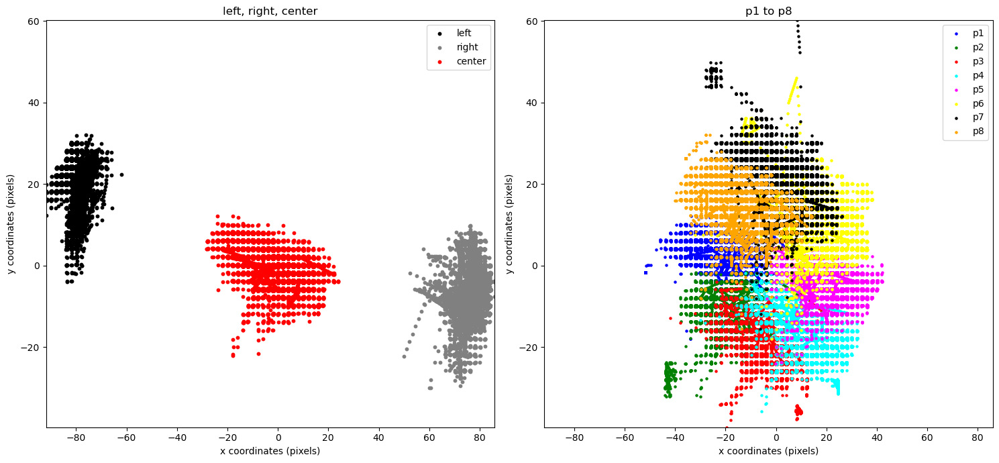

In [11]:
columns_of_interest = ['left.x','left.y','center.x','center.y','right.x','right.y','p1.x','p1.y','p2.x','p2.y','p3.x','p3.y','p4.x','p4.y','p5.x','p5.y','p6.x','p6.y','p7.x','p7.y','p8.x','p8.y']
coordinates_dict=lp.get_coordinates_dict(VideoData1, columns_of_interest)

columns_of_interest = ['left', 'right', 'center', 'p1', 'p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8']

# Filter out NaN values and calculate the min and max values for X and Y coordinates
x_min = min([coordinates_dict[f'{col}.x'][~np.isnan(coordinates_dict[f'{col}.x'])].min() for col in columns_of_interest])
x_max = max([coordinates_dict[f'{col}.x'][~np.isnan(coordinates_dict[f'{col}.x'])].max() for col in columns_of_interest])
y_min = min([coordinates_dict[f'{col}.y'][~np.isnan(coordinates_dict[f'{col}.y'])].min() for col in columns_of_interest])
y_max = max([coordinates_dict[f'{col}.y'][~np.isnan(coordinates_dict[f'{col}.y'])].max() for col in columns_of_interest])

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 7))

# Plot left, right, and center in the first plot
ax[0].set_title('left, right, center')
ax[0].scatter(coordinates_dict['left.x'], coordinates_dict['left.y'], color='black', label='left', s=10)
ax[0].scatter(coordinates_dict['right.x'], coordinates_dict['right.y'], color='grey', label='right', s=10)
ax[0].scatter(coordinates_dict['center.x'], coordinates_dict['center.y'], color='red', label='center', s=10)
ax[0].set_xlim([x_min, x_max])
ax[0].set_ylim([y_min, y_max])
ax[0].set_xlabel('x coordinates (pixels)')
ax[0].set_ylabel('y coordinates (pixels)')
ax[0].legend(loc='upper right')

# Plot p1 to p8 in the second plot with different colors and smaller markers
colors = ['blue', 'green', 'red', 'cyan', 'magenta', 'yellow', 'black', 'orange']
for idx, col in enumerate(columns_of_interest[3:]):
    ax[1].scatter(coordinates_dict[f'{col}.x'], coordinates_dict[f'{col}.y'], color=colors[idx], label=col, s=5)

ax[1].set_xlim([x_min, x_max])
ax[1].set_ylim([y_min, y_max])
ax[1].set_title('p1 to p8')
ax[1].set_xlabel('x coordinates (pixels)')
ax[1].set_ylabel('y coordinates (pixels)')
ax[1].legend(loc='upper right')

plt.tight_layout()
plt.show()

In [12]:
from scipy.signal import butter, filtfilt

############################################################################################################
# fit elypses on the 8 points to determine pupil centre and diameter
############################################################################################################

columns_of_interest = ['left.x','left.y','center.x','center.y','right.x','right.y','p1.x','p1.y','p2.x','p2.y','p3.x','p3.y','p4.x','p4.y','p5.x','p5.y','p6.x','p6.y','p7.x','p7.y','p8.x','p8.y']
coordinates_dict=lp.get_coordinates_dict(VideoData1, columns_of_interest)

theta = lp.find_horizontal_axis_angle(VideoData1, 'left', 'center')
center_point = lp.get_left_right_center_point(coordinates_dict)

columns_of_interest = ['left', 'right', 'center', 'p1', 'p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8']
remformatted_coordinates_dict = lp.get_reformatted_coordinates_dict(coordinates_dict, columns_of_interest)
centered_coordinates_dict = lp.get_centered_coordinates_dict(remformatted_coordinates_dict, center_point)
rotated_coordinates_dict = lp.get_rotated_coordinates_dict(centered_coordinates_dict, theta)

columns_of_interest = ['p1', 'p2', 'p3', 'p4', 'p5', 'p6', 'p7', 'p8']
ellipse_parameters_data, ellipse_center_points_data = lp.get_fitted_ellipse_parameters(rotated_coordinates_dict, columns_of_interest)

average_diameter = np.mean([ellipse_parameters_data[:,0], ellipse_parameters_data[:,1]], axis=0)

SleapVideoData1 = process.convert_arrays_to_dataframe(['Seconds', 'Ellipse.Diameter', 'Ellipse.Angle', 'Ellipse.Center.X', 'Ellipse.Center.Y'], [VideoData1['Seconds'].values, average_diameter, ellipse_parameters_data[:,2], ellipse_center_points_data[:,0], ellipse_center_points_data[:,1]])

############################################################################################################
# some aggressive filtering of the pupil diameter
############################################################################################################
# Butterworth filter parameters
cutoff = 5  # Hz
fs = 1 / np.median(np.diff(SleapVideoData1['Seconds']))  # Sampling frequency (Hz)
order = 6

b, a = butter(order, cutoff / (0.5 * fs), btype='low')
SleapVideoData1['Ellipse.Diameter.Filt'] = filtfilt(b, a, SleapVideoData1['Ellipse.Diameter'])

SleapVideoData1['Ellipse.Diameter'] = SleapVideoData1['Ellipse.Diameter'].rolling(window=12, center=True, min_periods=1).median()

print("✅ Done calculating pupil diameter and angle")

✅ Done calculating pupil diameter and angle


In [13]:
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=["Pupil Diameter", "Pupil Ellipse Long Axis Angle"],
    column_widths=[0.67, 0.33]  # left plot is twice as wide as right plot
)

fig.add_trace(
    go.Scatter(
        x=SleapVideoData1['Seconds'],
        y=SleapVideoData1['Ellipse.Diameter'],
        mode='lines',
        name="Pupil Diameter"
    ),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(
        x=SleapVideoData1['Seconds'],
        y=np.degrees(SleapVideoData1['Ellipse.Angle']),
        mode='markers',
        name="Ellipse Angle",
        marker=dict(size=1)
    ),
    row=1, col=2
)

fig.update_xaxes(title_text="Seconds", row=1, col=1)
fig.update_yaxes(title_text="Diameter", row=1, col=1)
fig.update_xaxes(title_text="Seconds", row=1, col=2)
fig.update_yaxes(title_text="Angle (degrees)", row=1, col=2)

fig.update_layout(
    height=500,
    width=1200,
    title_text="SLEAP VideoData1: Pupil Metrics"
)

fig.show()

In [14]:
############################################################################################################
# check if Second values match 1:1 between VideoData and SleapVideoData then merge them into VideoData
############################################################################################################

if VideoData1_Has_Sleap is True:
    if VideoData1['Seconds'].equals(SleapVideoData1['Seconds']) is False:
        print("❗ Video1: The 'Seconds' columns DO NOT correspond 1:1 between the two DataFrames. This should not happen")
    else:
        VideoData1 = VideoData1.merge(SleapVideoData1, on='Seconds', how='outer')
        del SleapVideoData1

if VideoData2_Has_Sleap is True:
    if VideoData2['Seconds'].equals(SleapVideoData2['Seconds']) is False:
        print("❗ Video2: The 'Seconds' columns DO NOT correspond 1:1 between the two DataFrames. This should not happen")
    else:
        VideoData2 = VideoData2.merge(SleapVideoData2, on='Seconds', how='outer')
        del SleapVideoData2
gc.collect()
None

R^2 between center point and ellipse center X data: 0.9680
R^2 between center point and ellipse center Y data: 0.5589


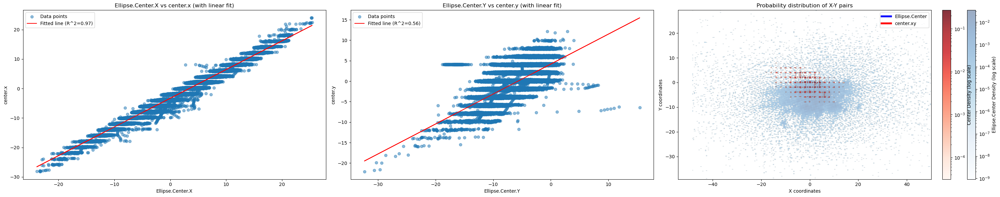

In [15]:
############################################################################################################
# Compare center.x and .y with ellipse.centre.x and .y distributions
############################################################################################################

# ------------------------------------------------------------------
# 1) Compute correlations
# ------------------------------------------------------------------
slope_x, intercept_x, r_value_x, p_value_x, std_err_x = linregress(
    VideoData1["Ellipse.Center.X"], 
    VideoData1["center.x"]
)
r_squared_x = r_value_x**2
print(f"R^2 between center point and ellipse center X data: {r_squared_x:.4f}")

slope_y, intercept_y, r_value_y, p_value_y, std_err_y = linregress(
    VideoData1["Ellipse.Center.Y"], 
    VideoData1["center.y"]
)
r_squared_y = r_value_y**2
print(f"R^2 between center point and ellipse center Y data: {r_squared_y:.4f}")

# ------------------------------------------------------------------
# 2) Create subplots
# ------------------------------------------------------------------
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 6))

# ------------------------------------------------------------------
# 3) Scatter plots + linear fits
# ------------------------------------------------------------------
# (a) For X data
ax[0].scatter(
    VideoData1["Ellipse.Center.X"], 
    VideoData1["center.x"], 
    alpha=0.5, 
    label="Data points"
)
ax[0].plot(
    VideoData1["Ellipse.Center.X"],
    intercept_x + slope_x * VideoData1["Ellipse.Center.X"],
    "r",
    label=f"Fitted line (R^2={r_squared_x:.2f})"
)
ax[0].set_xlabel("Ellipse.Center.X")
ax[0].set_ylabel("center.x")
ax[0].set_title("Ellipse.Center.X vs center.x (with linear fit)")
ax[0].legend()

# (b) For Y data
ax[1].scatter(
    VideoData1["Ellipse.Center.Y"], 
    VideoData1["center.y"], 
    alpha=0.5, 
    label="Data points"
)
ax[1].plot(
    VideoData1["Ellipse.Center.Y"],
    intercept_y + slope_y * VideoData1["Ellipse.Center.Y"],
    "r",
    label=f"Fitted line (R^2={r_squared_y:.2f})"
)
ax[1].set_xlabel("Ellipse.Center.Y")
ax[1].set_ylabel("center.y")
ax[1].set_title("Ellipse.Center.Y vs center.y (with linear fit)")
ax[1].legend()

# ------------------------------------------------------------------
# 4) 2D KDE for Ellipse.Center (blue)
# ------------------------------------------------------------------
x_ellipse = VideoData1["Ellipse.Center.X"].to_numpy()
y_ellipse = VideoData1["Ellipse.Center.Y"].to_numpy()
data_ellipse = np.vstack([x_ellipse, y_ellipse])

fkde_ellipse = fastKDE(data_ellipse)
pdf_ellipse = fkde_ellipse.pdf
x_axis_ellipse, y_axis_ellipse = fkde_ellipse.axes

im_ellipse = ax[2].imshow(
    pdf_ellipse,
    extent=[x_axis_ellipse.min(), x_axis_ellipse.max(), 
            y_axis_ellipse.min(), y_axis_ellipse.max()],
    aspect="auto",
    origin="lower",
    cmap="Blues",
    alpha=0.4,       # Lower alpha so red can be seen clearly
    norm=LogNorm(),
    zorder=1
)

cbar_ellipse = plt.colorbar(im_ellipse, ax=ax[2], orientation="vertical", fraction=0.046, pad=0.04)
cbar_ellipse.set_label("Ellipse.Center Density (log scale)")

# ------------------------------------------------------------------
# 5) 2D KDE for center (red)
# ------------------------------------------------------------------
x_center = VideoData1["center.x"].to_numpy()
y_center = VideoData1["center.y"].to_numpy()
data_center = np.vstack([x_center, y_center])

fkde_center = fastKDE(data_center)
pdf_center = fkde_center.pdf
x_axis_center, y_axis_center = fkde_center.axes

im_center = ax[2].imshow(
    pdf_center,
    extent=[x_axis_center.min(), x_axis_center.max(), 
            y_axis_center.min(), y_axis_center.max()],
    aspect="auto",
    origin="lower",
    cmap="Reds",
    alpha=0.8,        # Higher alpha to make red more visible
    norm=LogNorm(),
    zorder=2          # Above the blue distribution
)

cbar_center = plt.colorbar(im_center, ax=ax[2], orientation="vertical", fraction=0.046, pad=0.04)
cbar_center.set_label("Center Density (log scale)")

# ------------------------------------------------------------------
# 6) Final formatting
# ------------------------------------------------------------------
ax[2].set_xlabel("X coordinates")
ax[2].set_ylabel("Y coordinates")
ax[2].set_title("Probability distribution of X-Y pairs")

legend_elements = [
    Line2D([0], [0], color="blue", lw=4, label="Ellipse.Center"),
    Line2D([0], [0], color="red",  lw=4, label="center.xy")
]
ax[2].legend(handles=legend_elements, loc="upper right")

plt.tight_layout()
plt.show()


In [16]:
############################################################################################################
# save as df to csv to be loaded in the photometry/harp/etc. analysis notebook 
############################################################################################################
# reindex to aeon datetime to be done in the other notebook
 
if VideoData1_Has_Sleap:
    # Save  DataFrame as CSV to proper path and filename
    save_path1 = save_path / "Video_Sleap_Data1" / "Video_Sleap_Data1_1904-01-01T00-00-00.csv"
    save_path1.parent.mkdir(parents=True, exist_ok=True)
    #save_path1.parent.mkdir(parents=True, exist_ok=True)
    VideoData1.to_csv(save_path1)

if VideoData2_Has_Sleap:
    # Save  DataFrame as CSV to proper path and filename
    save_path2 = save_path / "Video_Sleap_Data2" / "Video_Sleap_Data2_1904-01-01T00-00-00.csv"
    save_path2.parent.mkdir(parents=True, exist_ok=True)
    #save_path2.parent.mkdir(parents=True, exist_ok=True)
    VideoData2.to_csv(save_path2)


# Saccade detection


In [17]:
VideoData1[["Seconds", "Ellipse.Center.X"]].head

<bound method NDFrame.head of               Seconds  Ellipse.Center.X
0       439096.797504        -11.776510
1       439104.000320        -11.840692
2       439104.016672        -11.545403
3       439104.033312        -11.545734
4       439104.050272        -11.732475
...               ...               ...
111853  440968.136288         -5.345447
111854  440968.152960         -5.472762
111855  440968.169632         -5.455669
111856  440968.186304         -5.418766
111857  440968.202976         -4.627875

[111858 rows x 2 columns]>

In [27]:
# 1. Preprocess:  smooth
df = VideoData1[["Ellipse.Center.X", "Seconds"]].copy()

df['X_smooth'] = (
    df['Ellipse.Center.X']
      .rolling(window=5, center=True)
      .median()
      .bfill()
      .ffill()
)

# 2. Compute instantaneous velocity
#   dt in seconds
df['dt'] = df['Seconds'].diff()
#   vel = dX / dt
df['vel_x'] = df['X_smooth'].diff() / df['dt']

# --- Plot smoothed trace and on separate y axis plot velocity---
# Create subplots with shared x-axis for synchronized zooming
fig = make_subplots(
    rows=2, cols=1,
    shared_xaxes=True,  # This ensures x-axis zoom synchronization
    vertical_spacing=0.1,
    subplot_titles=('X Position (px)', 'Velocity (px/s)')
)

# Add X_smooth to the first subplot
fig.add_trace(
    go.Scatter(
        x=df['Seconds'],
        y=df['X_smooth'],
        mode='lines',
        name='Smoothed X',
        line=dict(color='blue')
    ),
    row=1, col=1
)

# Add velocity to the second subplot
fig.add_trace(
    go.Scatter(
        x=df['Seconds'],
        y=df['vel_x'],
        mode='lines',
        name='Velocity',
        line=dict(color='red')
    ),
    row=2, col=1
)

# Update layout
fig.update_layout(
    title='Smoothed X and Velocity Traces (Synchronized Zoom)',
    height=600,  # Adjust height for two subplots
    showlegend=True,
    legend=dict(x=0.01, y=0.99)
)

# Update x-axes
fig.update_xaxes(title_text="Time (s)", row=2, col=1)

# Update y-axes
fig.update_yaxes(title_text="X Position (px)", row=1, col=1)
fig.update_yaxes(title_text="Velocity (px/s)", row=2, col=1)

fig.show()

# more complex approach 

In [36]:
def detect_saccades_refined(df, k=3, pct=0.2, refractory=0.100):
    """
    df must have columns: Seconds, X_smooth, vel_x.
    Returns DataFrame with one row per saccade:
      start_time, end_time, peak_vel, amplitude, direction
    """
    # 1) compute global thresholds
    abs_vel = df['vel_x'].abs().dropna()
    vel_thresh = abs_vel.mean() + k * abs_vel.std()
    pos_thresh, neg_thresh =  vel_thresh, -vel_thresh

    # 2) label rough segments
    df = df.copy()
    df['is_pos'] = df['vel_x'] > pos_thresh
    df['is_neg'] = df['vel_x'] < neg_thresh

    df['id_pos'] = (df['is_pos'] & ~df['is_pos'].shift(fill_value=False)).cumsum().where(df['is_pos'], 0)
    df['id_neg'] = (df['is_neg'] & ~df['is_neg'].shift(fill_value=False)).cumsum().where(df['is_neg'], 0)

    events = []
    for direction, seg_id_col, thr in [
        ('pos','id_pos', pos_thresh),
        ('neg','id_neg', neg_thresh)
    ]:
        for seg_id, seg in df.groupby(seg_id_col):
            if seg_id == 0: 
                continue

            t = seg['Seconds'].values
            v = seg['vel_x'].values
            # a) raw indices of first crossing
            #    (we know seg[0] is already above thr)
            #    so look for the first index i where v[i] > thr (or < thr)
            if direction=='pos':
                idx_cross = np.nonzero(v > thr)[0][0]
            else:
                idx_cross = np.nonzero(v < thr)[0][0]

            # b) interpolate to find sub-sample start crossing
            if idx_cross>0:
                t0, v0 = t[idx_cross-1], v[idx_cross-1]
                t1, v1 = t[idx_cross],   v[idx_cross]
                t_start_rough = t0 + (thr - v0)*(t1-t0)/(v1-v0)
            else:
                # already above threshold at first sample
                t_start_rough = t[0]

            # c) find the peak (or plateau) within this segment
            if direction=='pos':
                peak_i = np.argmax(v)
            else:
                peak_i = np.argmin(v)
            v_peak = v[peak_i]

            # d) define 20%-of-peak threshold (preserve sign)
            thr20 = pct * abs(v_peak) * np.sign(v_peak)

            # e) find raw end: first idx after peak where |v| < |thr20|
            after_peak = np.where(np.abs(v[peak_i:]) < abs(thr20))[0]
            if len(after_peak)==0:
                # didn’t return to baseline within segment—skip
                continue
            idx_end = peak_i + after_peak[0]

            # f) interpolate to get sub-sample end time
            if idx_end>0:
                t0_e, v0_e = t[idx_end-1], v[idx_end-1]
                t1_e, v1_e = t[idx_end],   v[idx_end]
                t_end = t0_e + (thr20 - v0_e)*(t1_e-t0_e)/(v1_e-v0_e)
            else:
                t_end = t[0]

            # g) walk backwards from peak to find when |v| last < |thr20|
            before_peak = np.where(np.abs(v[:peak_i][::-1]) < abs(thr20))[0]
            if len(before_peak)==0:
                # can’t find a clean baseline before peak → use rough start
                t_start = t_start_rough
            else:
                j = peak_i - before_peak[0]  # this is first index > thr20 going backward
                # j-1 is last below-thr20
                t0_s, v0_s = t[j-1], v[j-1]
                t1_s, v1_s = t[j],   v[j]
                t_start = t0_s + (thr20 - v0_s)*(t1_s-t0_s)/(v1_s-v0_s)

            # h) compute amplitude using interpolation of X_smooth
            X = df[['Seconds','X_smooth']].dropna()
            amp = np.interp(t_end,   X['Seconds'], X['X_smooth']) \
                - np.interp(t_start, X['Seconds'], X['X_smooth'])

            events.append({
                'start_time': t_start,
                'end_time':   t_end,
                'peak_vel':   v_peak,
                'amplitude':  amp,
                'direction':  direction
            })

    # 3) make DataFrame & apply refractory
    sacc = pd.DataFrame(events).sort_values('start_time').reset_index(drop=True)

    keep = []
    last_end = -np.inf
    for _, row in sacc.iterrows():
        if row['start_time'] - last_end >= refractory:
            keep.append(row)
            last_end = row['end_time']
    return pd.DataFrame(keep)


# ——————————————————————————————
# USAGE:
sacc_refined = detect_saccades_refined(df, k=3, pct=0.4, refractory=0.100)
print(sacc_refined)

import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# ── 1) Define window and subset ───────────────────────────────
t0_rel, t1_rel = 0, 1600
t0 = df['Seconds'].min() + t0_rel
t1 = df['Seconds'].min() + t1_rel

df_win = df[(df['Seconds'] >= t0) & (df['Seconds'] <= t1)]
s = sacc_refined[
    (sacc_refined['start_time'] >= t0) &
    (sacc_refined['end_time']   <= t1)
]

# ── 2) Interpolate to get X_smooth & vel_x at exact start/end ──
x_start = np.interp(s['start_time'], df_win['Seconds'], df_win['X_smooth'])
x_end   = np.interp(s['end_time'],   df_win['Seconds'], df_win['X_smooth'])
v_start = np.interp(s['start_time'], df_win['Seconds'], df_win['vel_x'])
v_end   = np.interp(s['end_time'],   df_win['Seconds'], df_win['vel_x'])

# ── 3) Build 2-row subplot (shared x-axis) ────────────────────
fig = make_subplots(
    rows=2, cols=1, shared_xaxes=True,
    vertical_spacing=0.05,
    row_heights=[0.6,0.4],
    subplot_titles=("Position (px)", "Velocity (px/s)")
)

# Position trace
fig.add_trace(go.Scattergl(
    x=df_win['Seconds'], y=df_win['X_smooth'],
    mode='lines', line=dict(width=1), name='Position'
), row=1, col=1)

# Position: start markers
fig.add_trace(go.Scattergl(
    x=s['start_time'], y=x_start,
    mode='markers',
    marker=dict(symbol='triangle-up', size=8, color='red'),
    name='Sac start'
), row=1, col=1)

# Position: end markers
fig.add_trace(go.Scattergl(
    x=s['end_time'], y=x_end,
    mode='markers',
    marker=dict(symbol='triangle-down', size=8, color='blue'),
    name='Sac end'
), row=1, col=1)


# Velocity trace
fig.add_trace(go.Scattergl(
    x=df_win['Seconds'], y=df_win['vel_x'],
    mode='lines', line=dict(width=1), name='Velocity'
), row=2, col=1)

# Velocity: start markers (hide legend duplicates)
fig.add_trace(go.Scattergl(
    x=s['start_time'], y=v_start,
    mode='markers',
    marker=dict(symbol='triangle-up', size=8, color='red'),
    showlegend=False
), row=2, col=1)

# Velocity: end markers
fig.add_trace(go.Scattergl(
    x=s['end_time'], y=v_end,
    mode='markers',
    marker=dict(symbol='triangle-down', size=8, color='blue'),
    showlegend=False
), row=2, col=1)


# ── 4) Layout tweaks ────────────────────────────────────────────
fig.update_layout(
    title=f"QC: {t0_rel}–{t1_rel} s Window",
    height=500,
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    margin=dict(l=50, r=50, t=60, b=40),
)

# shared x-axis formatting
fig.update_xaxes(title_text="Time (s)", range=[t0, t1], row=2, col=1)
fig.update_xaxes(showticklabels=False, row=1, col=1)

fig.show()

       start_time       end_time     peak_vel  amplitude direction
0   439174.147712  439174.161530   441.702356   1.693701       pos
1   439281.294016  439281.309539   503.098980   2.776958       pos
2   439294.243584  439294.275385   361.190555   7.879917       pos
3   439328.175776  439328.190890  -786.914056  -4.037064       neg
4   439333.658912  439333.701832   565.933591  15.552538       pos
5   439404.073184  439404.086455  -720.531306  -2.354525       neg
6   439515.135936  439515.151695  -490.514606  -2.823063       neg
7   439582.283616  439582.296594  -535.668970  -1.593243       neg
8   439593.133248  439593.149466  -593.582825  -3.689234       neg
9   439635.998496  439636.014837   394.179279   2.505607       pos
10  439659.164384  439659.177164  -715.528628  -1.987111       neg
11  439673.663872  439673.679830   393.935671   2.345954       pos
12  439803.592800  439803.625603   327.484005   5.123812       pos
13  439831.491840  439831.507661   489.046089   2.845172      

# simple approach

In [30]:
# 1. Compute symmetric thresholds
abs_vel = df['vel_x'].abs().dropna()
k = 3  # times std to use as threshold
vel_thresh = abs_vel.mean() + k * abs_vel.std()
pos_thresh =  vel_thresh
neg_thresh = -vel_thresh
print(f"pos_thresh = {pos_thresh:.1f}, neg_thresh = {neg_thresh:.1f} px/s")

# 2. Masks for each direction
df['is_sac_pos'] = df['vel_x'] > pos_thresh
df['is_sac_neg'] = df['vel_x'] < neg_thresh

# 3. Label contiguous runs
df['sac_pos_id'] = (
    (df['is_sac_pos'] & ~df['is_sac_pos'].shift(fill_value=False))
    .cumsum()
    .where(df['is_sac_pos'], 0)
)
df['sac_neg_id'] = (
    (df['is_sac_neg'] & ~df['is_sac_neg'].shift(fill_value=False))
    .cumsum()
    .where(df['is_sac_neg'], 0)
)

# 4. Aggregate each into summaries, then concat
def summarize(df, col_id, direction):
    return (
        df[df[col_id] > 0]
        .groupby(col_id)
        .agg(
            start_time=('Seconds', 'first'),
            end_time  =('Seconds', 'last'),
            peak_vel  =('vel_x', lambda x: x.max() if direction=='pos' else x.min()),
            amplitude =('X_smooth', lambda x: (x.max()-x.min()) if direction=='pos' else (x.min()-x.max()))
        )
        .assign(direction=direction)
    )

sac_pos = summarize(df, 'sac_pos_id', 'pos')
sac_neg = summarize(df, 'sac_neg_id', 'neg')

saccades = pd.concat([sac_pos, sac_neg], ignore_index=True)
print(f"Detected {len(saccades)} saccades ({sac_pos.shape[0]} pos, {sac_neg.shape[0]} neg)")

# Add a refractory period of 100 ms to saccade detection
refractory_period = 0.100  # seconds (100 ms)

# Sort saccades by start_time just in case
saccades = saccades.sort_values('start_time').reset_index(drop=True)

# Keep only saccades that are at least 100 ms apart
filtered_saccades = []
last_end_time = -np.inf

for idx, row in saccades.iterrows():
    if row['start_time'] - last_end_time >= refractory_period:
        filtered_saccades.append(row)
        last_end_time = row['end_time']

filtered_saccades = pd.DataFrame(filtered_saccades)
print(f"After applying 100 ms refractory period: {len(filtered_saccades)} saccades remain")


pos_thresh = 111.8, neg_thresh = -111.8 px/s
Detected 550 saccades (280 pos, 270 neg)
After applying 100 ms refractory period: 526 saccades remain


In [31]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 1) Define window and subset
t0_rel, t1_rel = 0, 1800
t0 = df['Seconds'].min() + t0_rel
t1 = df['Seconds'].min() + t1_rel

df_win = df[(df['Seconds'] >= t0) & (df['Seconds'] <= t1)]
sacs_win = filtered_saccades[
    (filtered_saccades['start_time'] >= t0) &
    (filtered_saccades['start_time'] <= t1)
]

pos = sacs_win[sacs_win['direction']=='pos']
neg = sacs_win[sacs_win['direction']=='neg']

# Pre‐compute the X_smooth at each saccade start for the position markers
x_pos_starts = np.interp(pos['start_time'], df_win['Seconds'], df_win['X_smooth'])
x_neg_starts = np.interp(neg['start_time'], df_win['Seconds'], df_win['X_smooth'])

# 2) Build 2-row subplot
fig = make_subplots(
    rows=2, cols=1,
    shared_xaxes=True,
    vertical_spacing=0.05,
    row_heights=[0.6, 0.4],
    subplot_titles=("Position (px)", "Velocity (px/s)")
)

# 3) Position trace + saccade markers
fig.add_trace(
    go.Scattergl(
        x=df_win['Seconds'],
        y=df_win['X_smooth'],
        mode='lines',
        line=dict(width=1),
        name='Position'
    ),
    row=1, col=1
)
# Pos saccade starts on pos plot
fig.add_trace(
    go.Scattergl(
        x=pos['start_time'],
        y=x_pos_starts,
        mode='markers',
        marker=dict(symbol='triangle-up', size=8, color='red'),
        showlegend=False
    ),
    row=1, col=1
)
# Neg saccade starts on pos plot
fig.add_trace(
    go.Scattergl(
        x=neg['start_time'],
        y=x_neg_starts,
        mode='markers',
        marker=dict(symbol='triangle-down', size=8, color='blue'),
        showlegend=False
    ),
    row=1, col=1
)

# 4) Velocity trace + saccade markers
fig.add_trace(
    go.Scattergl(
        x=df_win['Seconds'],
        y=df_win['vel_x'],
        mode='lines',
        line=dict(width=1),
        name='Velocity'
    ),
    row=2, col=1
)
# Pos saccade starts on vel plot
fig.add_trace(
    go.Scattergl(
        x=pos['start_time'],
        y=[pos_thresh]*len(pos),
        mode='markers',
        marker=dict(symbol='triangle-up', size=8, color='red'),
        name='Pos sacc start'
    ),
    row=2, col=1
)
# Neg saccade starts on vel plot
fig.add_trace(
    go.Scattergl(
        x=neg['start_time'],
        y=[neg_thresh]*len(neg),
        mode='markers',
        marker=dict(symbol='triangle-down', size=8, color='blue'),
        name='Neg sacc start'
    ),
    row=2, col=1
)

# 5) Layout
fig.update_layout(
    title=f"QC: {t0_rel}–{t1_rel} s Window",
    height=500,
    legend=dict(orientation='h', yanchor='bottom', y=1.02, xanchor='right', x=1),
    margin=dict(l=50, r=50, t=60, b=40),
)

# 6) X‐axis formatting
fig.update_xaxes(title_text="Time (s)", range=[t0, t1], row=2, col=1)
fig.update_xaxes(showticklabels=False, row=1, col=1)

fig.show()

In [55]:
from scipy import stats

# ══════════════════════════════════════════════════════════════════════════════════
# ROBUST SACCADE THRESHOLD DETERMINATION
# ══════════════════════════════════════════════════════════════════════════════════

# 1. ANALYZE VELOCITY DISTRIBUTION
vel_abs = np.abs(df['vel_x'].dropna())

# Basic statistics
vel_mean = np.mean(vel_abs)
vel_median = np.median(vel_abs)
vel_std = np.std(vel_abs)
vel_mad = stats.median_abs_deviation(vel_abs)  # More robust than std

print(f"Velocity Statistics:")
print(f"Mean absolute velocity: {vel_mean:.2f} px/s")
print(f"Median absolute velocity: {vel_median:.2f} px/s")
print(f"Standard deviation: {vel_std:.2f} px/s")
print(f"Median Absolute Deviation (MAD): {vel_mad:.2f} px/s")

# 2. MULTIPLE THRESHOLD APPROACHES
# Approach A: Standard deviation based (classical)
threshold_std_3 = vel_mean + 3 * vel_std
threshold_std_4 = vel_mean + 4 * vel_std
threshold_std_5 = vel_mean + 5 * vel_std

# Approach B: MAD-based (more robust to outliers)
threshold_mad_3 = vel_median + 3 * vel_mad
threshold_mad_4 = vel_median + 4 * vel_mad
threshold_mad_5 = vel_median + 5 * vel_mad

# Approach C: Percentile-based
threshold_p95 = np.percentile(vel_abs, 95)
threshold_p97 = np.percentile(vel_abs, 97)
threshold_p99 = np.percentile(vel_abs, 99)

# Approach D: Otsu's method (automatic threshold selection)
def otsu_threshold(data, n_bins=512):
    """Find optimal threshold using Otsu's method"""
    hist, bin_edges = np.histogram(data, bins=n_bins)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2
    
    # Normalize histogram
    hist = hist.astype(float) / hist.sum()
    
    # Calculate cumulative sums
    cum_sum = np.cumsum(hist)
    cum_mean = np.cumsum(hist * bin_centers)
    
    # Calculate between-class variance
    total_mean = cum_mean[-1]
    between_var = np.zeros_like(cum_sum)
    
    for i in range(len(cum_sum)):
        if cum_sum[i] > 0 and cum_sum[i] < 1:
            w0 = cum_sum[i]
            w1 = 1 - w0
            mu0 = cum_mean[i] / w0 if w0 > 0 else 0
            mu1 = (total_mean - cum_mean[i]) / w1 if w1 > 0 else 0
            between_var[i] = w0 * w1 * (mu0 - mu1) ** 2
    
    # Find threshold that maximizes between-class variance
    optimal_idx = np.argmax(between_var)
    return bin_centers[optimal_idx]

threshold_otsu = otsu_threshold(vel_abs)

# 3. DISPLAY ALL THRESHOLDS
print(f"\nProposed Thresholds:")
print(f"Standard deviation based:")
print(f"  3σ: {threshold_std_3:.2f} px/s")
print(f"  4σ: {threshold_std_4:.2f} px/s")
print(f"  5σ: {threshold_std_5:.2f} px/s")
print(f"MAD-based (robust):")
print(f"  3×MAD: {threshold_mad_3:.2f} px/s")
print(f"  4×MAD: {threshold_mad_4:.2f} px/s")
print(f"  5×MAD: {threshold_mad_5:.2f} px/s")
print(f"Percentile-based:")
print(f"  95th percentile: {threshold_p95:.2f} px/s")
print(f"  97th percentile: {threshold_p97:.2f} px/s")
print(f"  99th percentile: {threshold_p99:.2f} px/s")
print(f"Otsu's method: {threshold_otsu:.2f} px/s")

# 4. VISUALIZATION
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=[
        'Velocity Distribution (Linear Scale)',
        'Velocity Distribution (Log Scale)', 
        'Cumulative Distribution',
        'Time Series with Threshold Candidates'
    ],
    specs=[[{"secondary_y": False}, {"secondary_y": False}],
           [{"secondary_y": False}, {"secondary_y": False}]]
)

# Plot 1: Histogram (linear)
fig.add_trace(
    go.Histogram(x=vel_abs, nbinsx=100, name='Velocity', opacity=0.7),
    row=1, col=1
)

# Add threshold lines
thresholds = {
    '3σ': threshold_std_3,
    '4σ': threshold_std_4, 
    '3×MAD': threshold_mad_3,
    '99th %ile': threshold_p99,
    'Otsu': threshold_otsu
}

colors = ['red', 'orange', 'blue', 'green', 'purple']
for i, (name, thresh) in enumerate(thresholds.items()):
    fig.add_vline(x=thresh, line_dash="dash", line_color=colors[i], 
                  annotation_text=f"{name}: {thresh:.1f}", row=1, col=1)

# Plot 2: Histogram (log scale)
fig.add_trace(
    go.Histogram(x=vel_abs, nbinsx=100, name='Velocity (log)', opacity=0.7),
    row=1, col=2
)
fig.update_yaxes(type="log", row=1, col=2)

# Plot 3: Cumulative distribution
sorted_vel = np.sort(vel_abs)
cumulative = np.arange(1, len(sorted_vel) + 1) / len(sorted_vel)
fig.add_trace(
    go.Scatter(x=sorted_vel, y=cumulative*100, mode='lines', name='CDF'),
    row=2, col=1
)

# Plot 4: Time series with threshold candidates
time_subset = df['Seconds'].iloc[::10]  # Subsample for visibility
vel_subset = np.abs(df['vel_x'].iloc[::10])

fig.add_trace(
    go.Scatter(x=time_subset, y=vel_subset, mode='lines', 
               name='|Velocity|', line=dict(color='lightgray')),
    row=2, col=2
)

for i, (name, thresh) in enumerate(thresholds.items()):
    fig.add_hline(y=thresh, line_dash="dash", line_color=colors[i],
                  annotation_text=f"{name}", row=2, col=2)

# Update layout
fig.update_layout(
    height=800,
    title_text="Saccade Threshold Analysis",
    showlegend=False
)

fig.update_xaxes(title_text="Absolute Velocity (px/s)", row=1, col=1)
fig.update_xaxes(title_text="Absolute Velocity (px/s)", row=1, col=2)
fig.update_xaxes(title_text="Absolute Velocity (px/s)", row=2, col=1)
fig.update_xaxes(title_text="Time (s)", row=2, col=2)

fig.update_yaxes(title_text="Count", row=1, col=1)
fig.update_yaxes(title_text="Count (log)", row=1, col=2)
fig.update_yaxes(title_text="Cumulative %", row=2, col=1)
fig.update_yaxes(title_text="Velocity (px/s)", row=2, col=2)

fig.show()

# 5. RECOMMENDATION
print(f"\n🎯 RECOMMENDATIONS:")
print(f"1. For CONSERVATIVE detection (fewer false positives): Use 4-5σ or 4-5×MAD")
print(f"2. For SENSITIVE detection (catch more saccades): Use 3σ or 3×MAD")
print(f"3. For AUTOMATIC threshold: Use Otsu's method ({threshold_otsu:.1f} px/s)")
print(f"4. MAD-based thresholds are more robust to outliers than σ-based")
print(f"5. Consider your data characteristics and validation requirements")

# Suggested threshold (you can modify this logic)
if threshold_mad_3 > 20:  # Reasonable minimum for eye movements
    suggested_threshold = threshold_mad_3
    method_used = "3×MAD (robust)"
else:
    suggested_threshold = threshold_std_3
    method_used = "3σ (classical)"

print(f"\n✅ SUGGESTED THRESHOLD: {suggested_threshold:.1f} px/s ({method_used})")

Velocity Statistics:
Mean absolute velocity: 9.05 px/s
Median absolute velocity: 1.66 px/s
Standard deviation: 34.25 px/s
Median Absolute Deviation (MAD): 1.66 px/s

Proposed Thresholds:
Standard deviation based:
  3σ: 111.79 px/s
  4σ: 146.04 px/s
  5σ: 180.29 px/s
MAD-based (robust):
  3×MAD: 6.65 px/s
  4×MAD: 8.31 px/s
  5×MAD: 9.98 px/s
Percentile-based:
  95th percentile: 31.01 px/s
  97th percentile: 40.93 px/s
  99th percentile: 84.81 px/s
Otsu's method: 212.02 px/s



🎯 RECOMMENDATIONS:
1. For CONSERVATIVE detection (fewer false positives): Use 4-5σ or 4-5×MAD
2. For SENSITIVE detection (catch more saccades): Use 3σ or 3×MAD
3. For AUTOMATIC threshold: Use Otsu's method (212.0 px/s)
4. MAD-based thresholds are more robust to outliers than σ-based
5. Consider your data characteristics and validation requirements

✅ SUGGESTED THRESHOLD: 111.8 px/s (3σ (classical))


Detected 299 saccades


,onset_time,peak_time,offset_time,peak_vel,amplitude,duration
0,439116.282944,439116.282944,439116.316256,275.408461,4.990354,0.033312
1,439117.199552,439117.199552,439117.216224,686.690229,6.575859,0.016672
2,439123.949344,439123.966016,439123.966016,326.224544,5.438816,0.016672
3,439126.865888,439126.882560,439126.882560,567.516676,9.461638,0.016672
4,439127.449248,439127.465920,439127.465920,303.077789,5.052913,0.016672
...,...,...,...,...,...,...
294,440961.103232,440961.119872,440961.119872,363.732016,6.052501,0.016640
295,440961.569856,440961.569856,440961.586528,1048.818337,4.261236,0.016672
296,440962.236512,440962.253184,440962.269824,618.436569,13.278837,0.033312
297,440963.869760,440963.869760,440963.886432,782.901260,2.889788,0.016672


In [48]:
import plotly.graph_objects as go

fig = go.Figure()

# Add X_smooth (or X_interp) on primary y-axis
fig.add_trace(go.Scatter(
    x=df['Seconds'],
    y=df['X_smooth'],
    mode='lines',
    name='Smoothed X',
    line=dict(color='blue')
))

# Add velocity on secondary y-axis
fig.add_trace(go.Scatter(
    x=df['Seconds'],
    y=df['vel_x'],
    mode='lines',
    name='Velocity',
    line=dict(color='red'),
    yaxis='y2'
))

fig.update_layout(
    title='Smoothed X and Velocity Traces',
    xaxis_title='Time (s)',
    yaxis=dict(
        title='X Position (px)',
        title=dict(font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title='Velocity (px/s)',
        title=dict(font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right'
    ),
    legend=dict(x=0.01, y=0.99)
)

fig.show(renderer='browser')

SyntaxError: keyword argument repeated: title (3398309723.py, line 29)

# PRE_ANR code

In [ ]:
# detect saccades 
df = VideoData1.copy()

df.index = pd.to_datetime(df.index * (1 / framerate), unit='s')

# 1) Compute velocity (units/s). Filter/diff/filter. Because sample rate is 1000 Hz, diff is * 1000.
window_size = int(round(2 / framerate * 1000))
df["velocity"] = df["Ellipse.Center.X"].rolling(window=window_size, center=True, min_periods=1).mean()
df["velocity"] = df["velocity"].diff() * 1000
window_size = int(round(4 / framerate * 1000))
df["velocity"] = df["velocity"].rolling(window=window_size, center=True, min_periods=1).mean()

# 2) Define a velocity threshold for saccades (adjust as needed)
# implement adaptive filter in the future 

# 3) Create a boolean mask for samples exceeding the threshold
df["is_saccade"] = df["velocity"].abs() > threshold

# 4) Group consecutive saccade samples to form saccade events.
#    Label each contiguous "True" block with a unique ID.
df["saccade_id"] = (df["is_saccade"] & ~df["is_saccade"].shift(fill_value=False)).cumsum() * df["is_saccade"]

# 5) Extract saccade onset times and basic details for each saccade.
saccade_events = []
for sacc_id, group in df.groupby("saccade_id"):
    if sacc_id == 0:
        continue
    saccade_time = group.index[0]
    peak_time = group["velocity"].abs().idxmax()  # Save the time when the absolute velocity peaks
    peak_velocity = group["velocity"].abs().max()
    direction = "positive" if group["velocity"].mean() > 0 else "negative"
    
    saccade_events.append({
        "saccade_id": sacc_id,
        "saccade_time": saccade_time,
        "peak_time": peak_time,         # New column for peak time
        "peak_velocity": peak_velocity,
        "direction": direction
    })

# 6) Apply a refractory period of 50 ms: if 2 saccade events occur within 50 ms, keep only the first.
filtered_saccade_events = []
last_event_time = None  # Initialize as None

for event in saccade_events:
    if last_event_time is None or (event["saccade_time"] - last_event_time) >= refractory_period:
        filtered_saccade_events.append(event)
        last_event_time = event["saccade_time"]


# 7) For each filtered saccade event, calculate the baseline and relative peak.
frame_duration = 1 / framerate  # seconds per frame
for event in filtered_saccade_events:
    saccade_time = event["saccade_time"]
    # Baseline: average the data for 3 frames immediately BEFORE the saccade onset.
    baseline_start = saccade_time - pd.Timedelta(seconds=3 * frame_duration)
    baseline = df.loc[baseline_start:saccade_time, "Ellipse.Center.X"].mean()
    event["baseline"] = baseline

    # Relative peak: in the next 40 ms after the saccade onset, measure the peak change relative to the baseline.
    window_end = saccade_time + pd.Timedelta(milliseconds=500)
    saccade_window = df.loc[saccade_time:window_end, "Ellipse.Center.X"]
    if event["direction"] == "positive":
        relative_peak = saccade_window.max() - baseline
    else:
        relative_peak = baseline - saccade_window.min()
    event["relative_peak"] = relative_peak

# Create a DataFrame of the filtered saccade events including the new metrics.
results_df = pd.DataFrame(filtered_saccade_events)


TypeError: '>' not supported between instances of 'Timedelta' and 'float'

In [17]:
if plot_saccade_detection_QC:
    pio.renderers.default = 'browser'
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df.index, y=df["velocity"], mode="lines", name="Velocity", line=dict(color="lightgrey", width=1)))
    fig.add_trace(go.Scatter(x=df.index, y=df["Ellipse.Center.X"], mode="lines", name="Ellipse.Center.X", line=dict(color="darkgrey", width=1), yaxis="y2"))
    if not results_df.empty:
        pos_df = results_df[results_df["direction"] == "positive"]
        neg_df = results_df[results_df["direction"] == "negative"]
        if not pos_df.empty:
            pos_starts = pos_df["saccade_time"]
            pos_y = df.loc[pos_starts, "Ellipse.Center.X"]
            fig.add_trace(go.Scatter(x=pos_starts, y=pos_y, mode="markers",
                                     marker=dict(symbol="circle-open", size=10, line=dict(width=2, color="red")),
                                     name="Positive Saccade Onsets", yaxis="y2"))
        if not neg_df.empty:
            neg_starts = neg_df["saccade_time"]
            neg_y = df.loc[neg_starts, "Ellipse.Center.X"]
            fig.add_trace(go.Scatter(x=neg_starts, y=neg_y, mode="markers",
                                     marker=dict(symbol="circle-open", size=10, line=dict(width=2, color="blue")),
                                     name="Negative Saccade Onsets", yaxis="y2"))
    fig.update_layout(
        title="Velocity and Ellipse.Center.X",
        xaxis_title="Time",
        yaxis=dict(title="Velocity"),
        yaxis2=dict(title="Ellipse.Center.X", overlaying="y", side="right")
    )
    fig.show()


In [21]:
############################################################################################################
# INVESTIGATE issue of long stretches of consecutive very low inference predicition scores 
############################################################################################################


score_cutoff = 0.0000001
columns_of_interest = ['left.score','center.score','right.score','p1.score','p2.score','p3.score','p4.score','p5.score','p6.score','p7.score','p8.score']
total_points = len(VideoData1)


for col in columns_of_interest:
    count_below_threshold = (VideoData1[col] < score_cutoff).sum()
    percentage_below_threshold = (count_below_threshold / total_points) * 100
    
    # Find the longest consecutive series below threshold
    below_threshold = VideoData1[col] < score_cutoff
    longest_series = 0
    current_series = 0
    
    for value in below_threshold:
        if value:
            current_series += 1
            if current_series > longest_series:
                longest_series = current_series
        else:
            current_series = 0
    
    print(f"Column: {col} | Values below {score_cutoff}: {count_below_threshold} ({percentage_below_threshold:.2f}%) | Longest consecutive frame series: {longest_series}")


Column: left.score | Values below 1e-07: 2526 (2.26%) | Longest consecutive frame series: 360
Column: center.score | Values below 1e-07: 601 (0.54%) | Longest consecutive frame series: 294
Column: right.score | Values below 1e-07: 4414 (3.95%) | Longest consecutive frame series: 101
Column: p1.score | Values below 1e-07: 538 (0.48%) | Longest consecutive frame series: 274
Column: p2.score | Values below 1e-07: 415 (0.37%) | Longest consecutive frame series: 59
Column: p3.score | Values below 1e-07: 406 (0.36%) | Longest consecutive frame series: 42
Column: p4.score | Values below 1e-07: 634 (0.57%) | Longest consecutive frame series: 118
Column: p5.score | Values below 1e-07: 632 (0.57%) | Longest consecutive frame series: 278
Column: p6.score | Values below 1e-07: 565 (0.51%) | Longest consecutive frame series: 63
Column: p7.score | Values below 1e-07: 319 (0.29%) | Longest consecutive frame series: 40
Column: p8.score | Values below 1e-07: 570 (0.51%) | Longest consecutive frame seri

In [22]:
pympler_memory_df = utils.get_pympler_memory_usage(top_n=10)

⚠️ Skipping im_ellipse: invalid option: reset(base=-1789568)
⚠️ Skipping cbar_ellipse: invalid option: reset(base=-1789568)
⚠️ Skipping im_center: invalid option: reset(base=-1789568)
⚠️ Skipping cbar_center: invalid option: reset(base=-1789568)
🔹 Top Memory-Consuming Variables (in MB):


,Variable,Size (MB)
142,df,40.834543
54,coordinates_dict,37.557358
49,VideoData1,34.136478
102,rotated_coordinates_dict,18.777382
101,centered_coordinates_dict,18.777382
100,remformatted_coordinates_dict,18.777382
126,fkde_ellipse,10.378876
133,fkde_center,8.536057
63,fig,3.540871
103,ellipse_parameters_data,2.560226



🔹 Total Memory Used: 211.06 MB
